# DFU-MobileNetV2

In [2]:
# Mostra configurações do ambiente
!nvidia-smi -L
!lscpu

/bin/bash: nvidia-smi: command not found
Architecture:                       x86_64
CPU op-mode(s):                     32-bit, 64-bit
Byte Order:                         Little Endian
Address sizes:                      46 bits physical, 48 bits virtual
CPU(s):                             4
On-line CPU(s) list:                0-3
Thread(s) per core:                 2
Core(s) per socket:                 2
Socket(s):                          1
NUMA node(s):                       1
Vendor ID:                          GenuineIntel
CPU family:                         6
Model:                              79
Model name:                         Intel(R) Xeon(R) CPU @ 2.20GHz
Stepping:                           0
CPU MHz:                            2200.178
BogoMIPS:                           4400.35
Hypervisor vendor:                  KVM
Virtualization type:                full
L1d cache:                          64 KiB
L1i cache:                          64 KiB
L2 cache:                   

In [2]:
# Instalando bibliotecas
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras import optimizers
from tensorflow.keras import losses
from tensorflow.keras import callbacks
from tensorflow.keras import metrics
from sklearn.metrics import roc_curve, auc
import matplotlib as mat
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sn
import os


print(tf.__version__)
print(mat.__version__)
print(np.__version__)

2024-06-04 11:21:02.055020: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-04 11:21:02.055126: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-04 11:21:02.169676: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


2.15.0
3.7.5
1.26.4


In [3]:
# Configurações do Matplot
plt.rc('axes', labelsize=12, titlesize=16)
plt.rc('legend', fontsize=16) 
plt.rc('figure', titlesize=16) 

In [4]:
# Definindo Constantes 
TRAIN_PATH = '../input/diabetic-foot-ulcer-dfu/DFU/Patches'
TEST_PATH = '../input/diabetic-foot-ulcer-dfu/DFU/TestSet'

BATCH_SIZE = 32
IMAGE_HEIGHT = 224
IMAGE_WIDTH = 224
NUM_CLASSES = 2
EPOCHS = 30
CLASS_NAMES = ['Normal(Healthy skin)', 'Abnormal(Ulcer)']
TRANSLATE_CLASS_NAMES = ['Saudável', 'Úlcera'] 
AUTOTUNE = tf.data.AUTOTUNE

In [5]:
# Separando conjunto de treinamento, validação e teste
train_ds, validation_ds = image_dataset_from_directory(
    TRAIN_PATH,
    labels = 'inferred',
    validation_split = 0.2,
    batch_size = BATCH_SIZE,
    image_size = (IMAGE_WIDTH, IMAGE_HEIGHT),
    subset = 'both',
    class_names = CLASS_NAMES,
    seed = 0
)

# Dividindo o dataset de validação ao meio
# para criar o dataset de teste rotulado
test_ds = validation_ds.take(2)
validation_ds = validation_ds.skip(2)

# Mostrando rótulos
class_names = train_ds.class_names
print(class_names)

Found 1055 files belonging to 2 classes.
Using 844 files for training.
Using 211 files for validation.
['Normal(Healthy skin)', 'Abnormal(Ulcer)']


In [6]:
# Realizando caching e prefetching para otimização
train_ds = train_ds.cache().prefetch(buffer_size = AUTOTUNE)
validation_ds = validation_ds.cache().prefetch(buffer_size = AUTOTUNE)

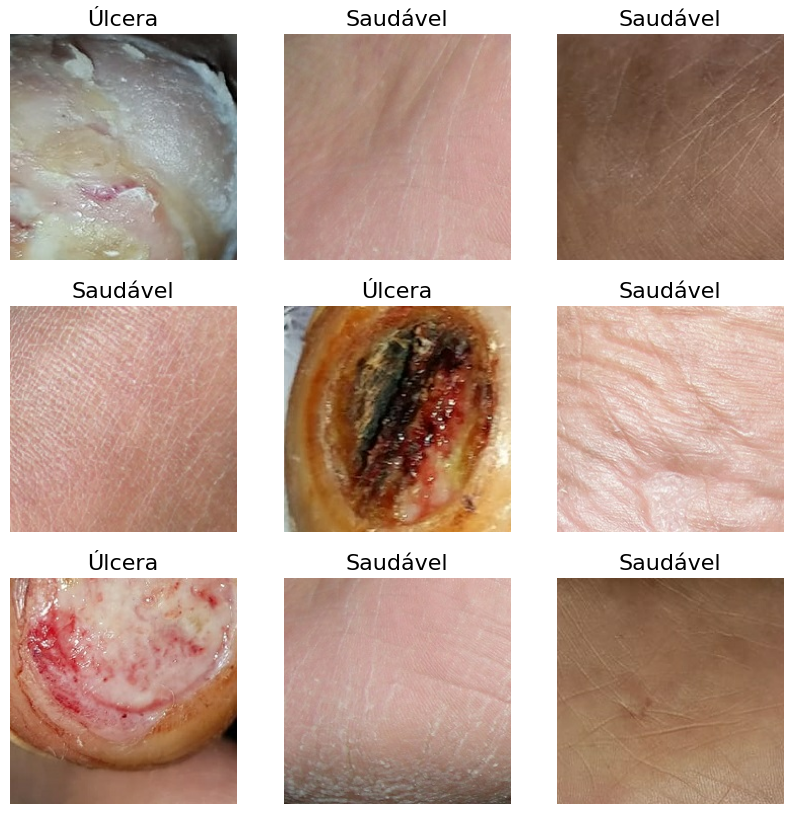

In [7]:
# Visualizando o dataset de treinamento
plt.figure(figsize = (10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        title = 'Saudável' if class_names[labels[i]] == 'Normal(Healthy skin)' else 'Úlcera'
        plt.title(title)
        plt.axis("off")

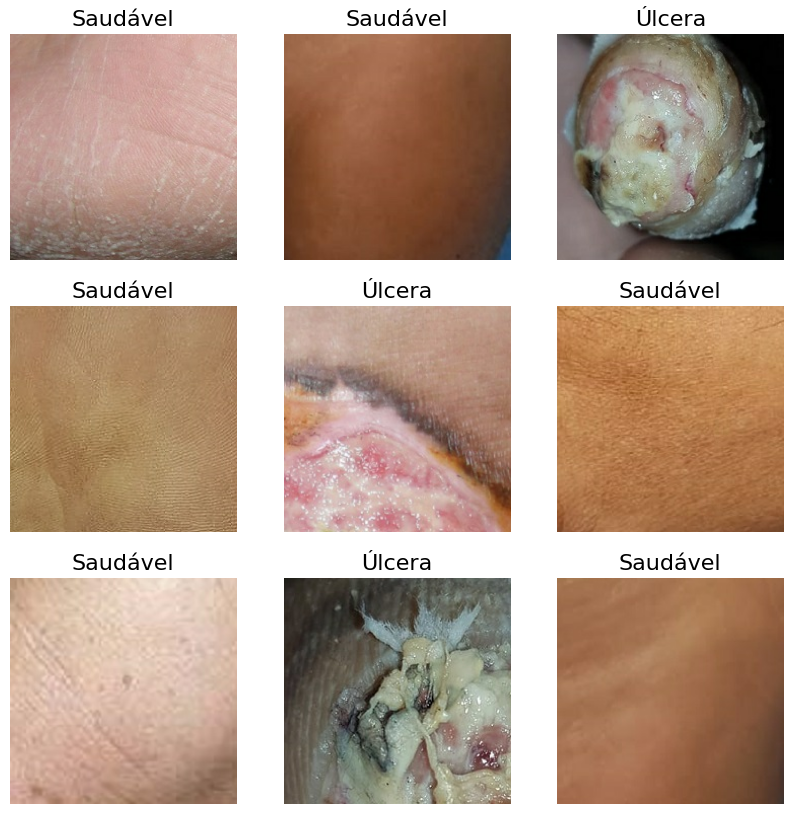

In [8]:
# Visualizando o dataset de validação
plt.figure(figsize = (10, 10))

for images, labels in validation_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        title = 'Saudável' if class_names[labels[i]] == 'Normal(Healthy skin)' else 'Úlcera'
        plt.title(title)
        plt.axis("off")

In [9]:
# Configurando camada de data augmentation
img_augmentation = Sequential(
    [
        layers.RandomRotation(factor = 0.15),
        layers.RandomTranslation(height_factor = 0.1, width_factor = 0.1),
        layers.RandomFlip(),
        layers.GaussianNoise(stddev = 0.09),
        layers.RandomContrast(factor = 0.1),
    ],
    name = "img_augmentation"
)

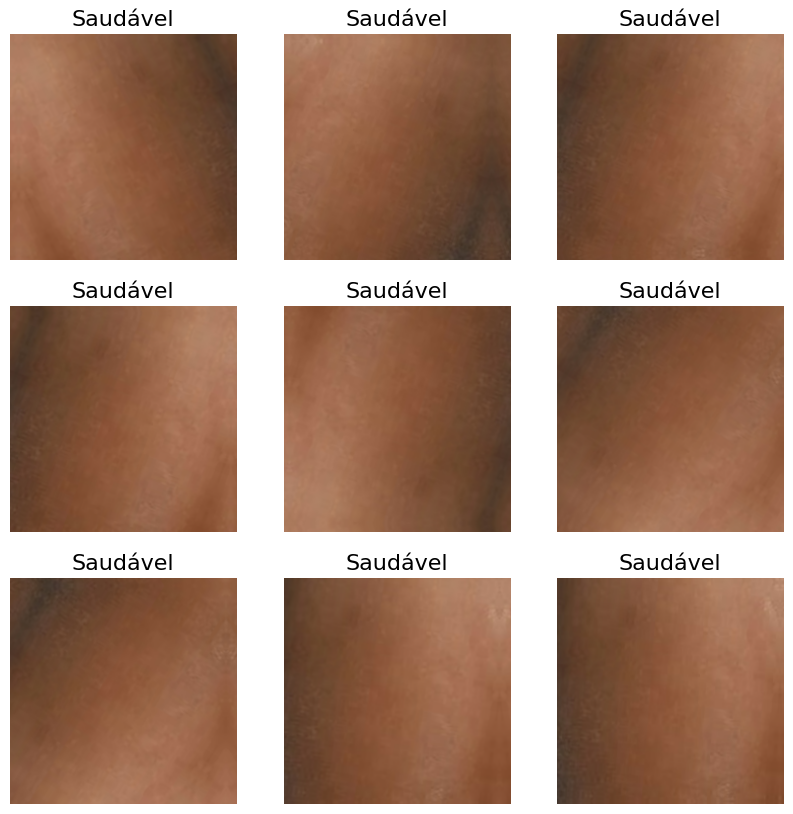

In [10]:
# Visualizando as operações de aumento de dados
plt.figure(figsize = (10, 10))
for image, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        aug_img = img_augmentation(tf.expand_dims(image[1], axis = 0))
        plt.imshow(aug_img[0].numpy().astype("uint8"))
        title = 'Saudável' if class_names[labels[1]] == 'Normal(Healthy skin)' else 'Úlcera'
        plt.title(title)
        plt.axis("off")

In [11]:
# Definindo callbacks de redução da taxa de aprendizado e de parada antecipada
lr_callback = callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.8,
                                            patience=3, verbose=1, mode='min',
                                            min_lr=0.00005)

stop_callback = callbacks.EarlyStopping(monitor='val_loss', patience=10, verbose=1,
                                       mode='min', restore_best_weights=True)

In [12]:
# Definindo métricas
def recall(y_true, y_pred):
    metric = metrics.Recall()
    metric.update_state(y_true, y_pred)
    value = metric.result()
    return value

def precision(y_true, y_pred):
    metric = metrics.Precision()
    metric.update_state(y_true, y_pred)
    value = metric.result()
    return value

def tp(y_true, y_pred):
    metric = metrics.TruePositives()
    metric.update_state(y_true, y_pred)
    value = metric.result()
    return tf.get_static_value(value)

def tn(y_true, y_pred):
    metric = metrics.TrueNegatives()
    metric.update_state(y_true, y_pred)
    value = metric.result()
    return tf.get_static_value(value)

def fp(y_true, y_pred):
    metric = metrics.FalsePositives()
    metric.update_state(y_true, y_pred)
    value = metric.result()
    return tf.get_static_value(value)

def fn(y_true, y_pred):
    metric = metrics.FalseNegatives()
    metric.update_state(y_true, y_pred)
    value = metric.result()
    return tf.get_static_value(value)

def specificity(val_tn, val_fp):
    return val_tn / (val_tn + val_fp)

def positive_precision(val_tp, val_fp):
    return val_tp / (val_tp + val_fp)

def negative_precision(val_tp, val_fp):
    return val_tn / (val_tn + val_fn)

def auc(y_true, y_pred):
    metric = metrics.AUC(num_thresholds=3)
    metric.update_state(y_true, y_pred)
    value = metric.result()
    return value

def f1_score(precision, recall):
    value = 2 * (precision * recall) / (precision + recall)
    return value

In [13]:
# Inicializando o modelo
def build_model():
    inputs = layers.Input(shape = (IMAGE_WIDTH, IMAGE_HEIGHT, 3))
    x = img_augmentation(inputs)
    
    model = MobileNetV2(include_top = False, weights = 'imagenet', input_tensor = x)
    model.trainable = False
    
    # Reconstruindo o topo
    x = layers.GlobalAveragePooling2D(name="avg_pool")(model.output)
    x = layers.BatchNormalization()(x)
    top_dropout_rate = 0.3
    x = layers.Dropout(top_dropout_rate, name="top_dropout")(x)
    predictions = layers.Dense(NUM_CLASSES, activation = "sigmoid", name = "pred")(x)
    
    # Compilando
    model = tf.keras.Model(inputs, predictions, name="MobileNet")
    optimizer = optimizers.AdamW(learning_rate=1e-3)
    loss = losses.SparseCategoricalCrossentropy()
    model.compile(optimizer=optimizer, loss=loss, metrics=['accuracy'])
    model.summary()
    
    return model

In [14]:
model = build_model()

/tmp/ipykernel_34/1474103034.py:6: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  model = MobileNetV2(include_top = False, weights = 'imagenet', input_tensor = x)


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [15]:
def join_batches(batches):
    all_images = tf.concat([images for images,_ in batches], axis=0)
    all_classes = tf.concat([labels for _,labels in batches], axis=0)

    return all_images, all_classes

In [16]:
# from warnings import filterwarnings
# Construindo classe que calcula as métricas durante o treinamento
class MetricsCallback(tf.keras.callbacks.Callback):
    def __init__(self, val_data):
        super().__init__()
        self.validation_data = val_data
    
    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
                
        if(self.validation_data):
            images, val_targ = join_batches(self.validation_data.take(-1))
            val_predict = np.argmax(model.predict(np.array(images), verbose=0), axis = 1)
            _val_precision = precision(val_targ, val_predict)
            _val_recall = recall(val_targ, val_predict)
            _val_f1 = f1_score(_val_precision, _val_recall)

            logs['val_precision'] = _val_precision
            logs['val_recall'] = _val_recall
            logs['val_f1'] = _val_f1

            print(f' - val_precision: {_val_precision} - val_recall: {_val_recall} - val_f1: {_val_f1}', end = " ")
                
metrics_callback = MetricsCallback(validation_ds)

In [17]:
history = model.fit(train_ds, validation_data = validation_ds, 
                    callbacks = [lr_callback, stop_callback, metrics_callback],
                    epochs = EPOCHS, verbose = 1)

Epoch 1/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 17s 319ms/step - accuracy: 0.7469 - loss: 0.5567 - val_accuracy: 0.7619 - val_loss: 0.4108 - learning_rate: 0.0010 - val_precision: 0.6991 - val_recall: 0.9875 - val_f1: 0.8187
Epoch 2/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 83ms/step - accuracy: 0.8221 - loss: 0.3905 - val_accuracy: 0.7891 - val_loss: 0.3881 - learning_rate: 0.0010 - val_precision: 0.7248 - val_recall: 0.9875 - val_f1: 0.8360
Epoch 3/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.8808 - loss: 0.3211 - val_accuracy: 0.7755 - val_loss: 0.3955 - learning_rate: 0.0010 - val_precision: 0.7117 - val_recall: 0.9875 - val_f1: 0.8272
Epoch 4/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.8913 - loss: 0.2903 - val_accuracy: 0.7959 - val_loss: 0.4307 - learning_rate: 0.0010 - val_precision: 0.7315 - val_recall: 0.9875 - val_f1: 0.8404
Epoch 5/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 82ms/step - accuracy: 0.8927 - loss: 0.2907 - val_accuracy: 0.8776 - val_loss: 0.3069 - learning_rate: 0.

In [18]:
model_path = f'{os.getcwd()}/model.keras'
history_path = f'{os.getcwd()}/history.keras'

model.save(model_path)
np.save(history_path, history.history)

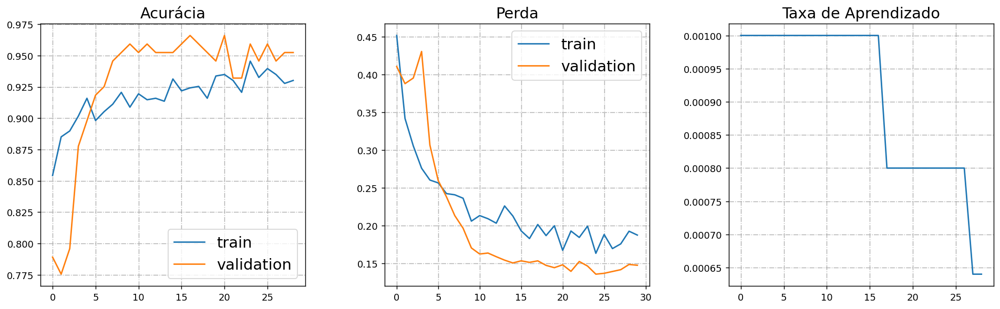

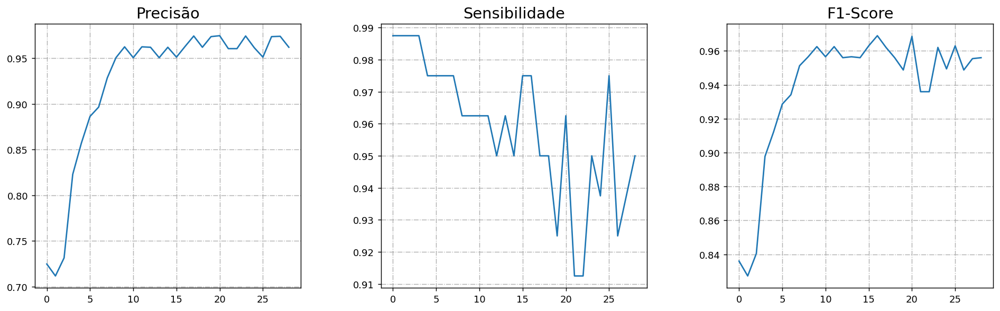

In [19]:
fig1, axs1 = plt.subplots(1,3, figsize = (18,5), dpi = 130)
fig1.subplots_adjust(wspace=0.3, hspace=0.5)

axs1[0].grid(linestyle="dashdot")
axs1[0].set_title("Acurácia")
axs1[0].plot(history.history['accuracy'][1:])
axs1[0].plot(history.history['val_accuracy'][1:])
axs1[0].legend(["train", "validation"], loc="lower right")

axs1[1].grid(linestyle="dashdot")
axs1[1].set_title("Perda")
axs1[1].plot(history.history['loss'])
axs1[1].plot(history.history['val_loss'])
axs1[1].legend(["train", "validation"], loc="upper right")

axs1[2].grid(linestyle="dashdot")
axs1[2].set_title("Taxa de Aprendizado")
axs1[2].plot(history.history['learning_rate'][1:])
fig2, axs2 = plt.subplots(1,3, figsize = (18,5), dpi = 130)

axs2[0].grid(linestyle="dashdot")
axs2[0].set_title("Precisão")
axs2[0].plot(history.history['val_precision'][1:])

axs2[1].grid(linestyle="dashdot")
axs2[1].set_title("Sensibilidade")
axs2[1].plot(history.history['val_recall'][1:])

axs2[2].grid(linestyle="dashdot")
axs2[2].set_title("F1-Score")
axs2[2].plot(history.history['val_f1'][1:])
fig2.subplots_adjust(wspace=0.3, hspace=0.5)

In [20]:
COLUNAS = ['Acurácia', 'Precisão', 'Sensibilidade', 'F1-Score']
history_df = pd.DataFrame(history.history)
history_df['val_precision'] = history_df['val_precision'].map(lambda tensor: tensor.numpy())
history_df['val_recall'] = history_df['val_recall'].map(lambda tensor: tensor.numpy())
history_df['val_f1'] = history_df['val_f1'].map(lambda tensor: tensor.numpy())
history_df = history_df.rename({'accuracy': 'Acurácia', 
                 'val_precision': 'Precisão',
                'val_recall': 'Sensibilidade',
                'val_f1': 'F1-Score',}, axis=1)
# print(history_df[COLUNAS].to_markdown())
display(history_df[COLUNAS])

,Acurácia,Precisão,Sensibilidade,F1-Score
0,0.806872,0.699115,0.9875,0.818653
1,0.854265,0.724771,0.9875,0.835979
2,0.885071,0.711712,0.9875,0.827225
3,0.889810,0.731481,0.9875,0.840425
4,0.901659,0.822917,0.9875,0.897727
5,0.915877,0.857143,0.9750,0.912281
6,0.898104,0.886364,0.9750,0.928571
7,0.905213,0.896552,0.9750,0.934132
8,0.911137,0.928571,0.9750,0.951219
9,0.920616,0.950617,0.9625,0.956522


In [29]:
images, y_true = join_batches(test_ds.take(-1))
y_pred = np.argmax(model.predict(np.array(images)), axis = 1)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


In [22]:
val_precision = precision(y_true, y_pred)
val_recall = recall(y_true, y_pred)
val_auc = auc(y_true, y_pred)
val_f1 = f1_score(val_precision, val_recall)
val_tp = tp(y_true, y_pred)
val_tn = tn(y_true, y_pred)
val_fp = fp(y_true, y_pred)
val_fn = fn(y_true, y_pred)
val_specificity = specificity(val_tp, val_fp)
val_positive_precision = positive_precision(val_tp, val_recall)
val_negative_precision = negative_precision(val_precision, val_recall)
print(f'Precisão: {val_precision}')
print(f'Sensibilidade: {val_recall}')
print(f'Especificidade: {val_specificity}')
print(f'Precisão Positiva: {val_positive_precision}')
print(f'Precisão Negativa: {val_negative_precision}')
print(f'AUC: {val_auc}')
print(f'F1-Score: {val_f1}')

Precisão: 0.8620689511299133
Sensibilidade: 0.9615384340286255
Especificidade: 0.8620689511299133
Precisão Positiva: 0.9629629850387573
Precisão Negativa: 0.9714285731315613
AUC: 0.9281376004219055
F1-Score: 0.9090908765792847


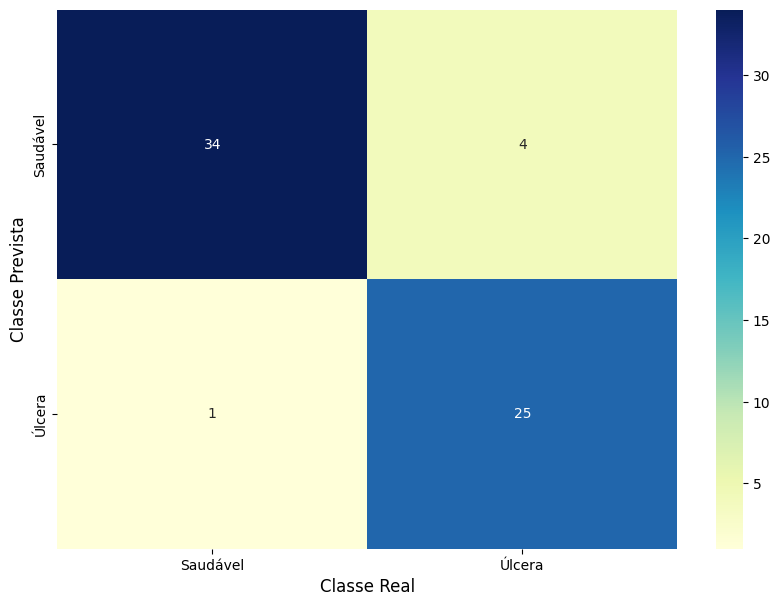

In [23]:
# Plotando matriz de confusão
td_class_names = []
df_cm = tf.math.confusion_matrix(labels=y_true, predictions=y_pred).numpy()
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True,  
           cmap = 'YlGnBu', 
           xticklabels = TRANSLATE_CLASS_NAMES, 
           yticklabels = TRANSLATE_CLASS_NAMES)
sn.set(font_scale=1.4)
plt.xlabel('Classe Real')
plt.ylabel('Classe Prevista')
plt.savefig('heatmap.png')
plt.savefig('heatmap.pdf')

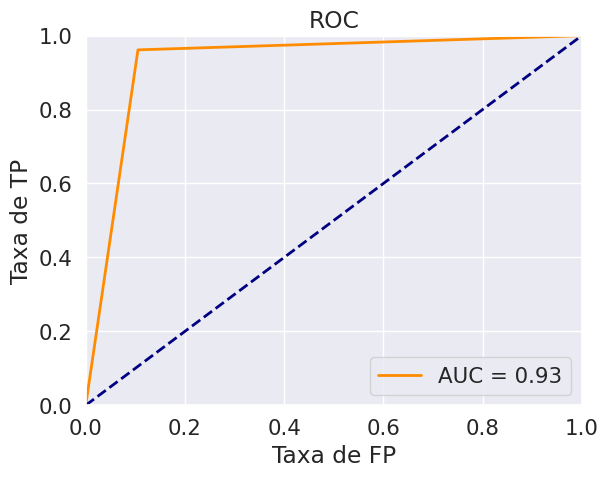

In [24]:
# Plotando curva ROC
fpr, tpr, _ = roc_curve(y_true, y_pred)
lw = 2
plt.title('ROC')
plt.plot(fpr, tpr, lw=lw, color="darkorange", label = 'AUC = %0.2f' % val_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--")
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('Taxa de TP')
plt.xlabel('Taxa de FP')
plt.show()

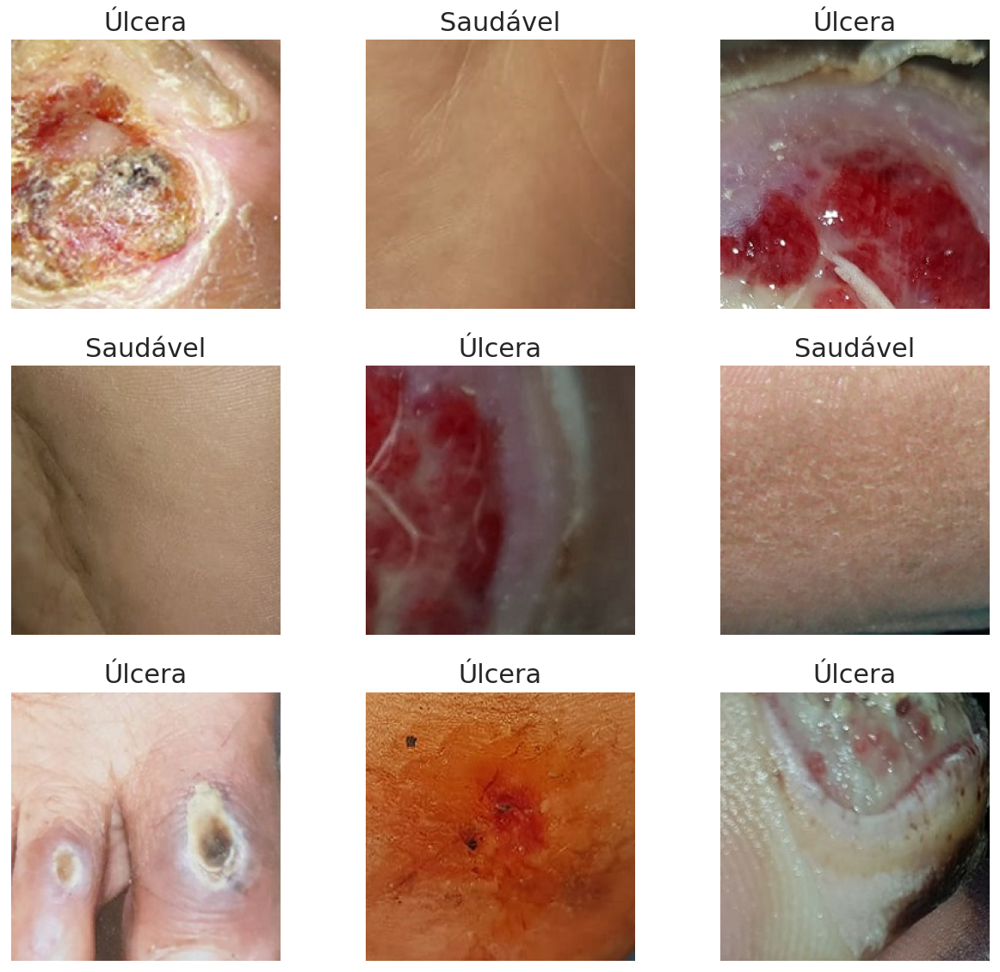

In [33]:
# Visualizando predição das imagens do conjunto de teste
rows = 3
cols = 3
last_index = 0

fig, axs = plt.subplots(rows, cols, figsize = (10,3*rows), dpi = 130)

for i in range(rows):
    for j in range(cols):
        index = i * cols + j + last_index
        axs[i][j].imshow(images[index].numpy().astype("uint8"))
        title = 'Saudável' if class_names[y_pred[index]] == 'Normal(Healthy skin)' else 'Úlcera'
        axs[i][j].set_title(title)
        axs[i][j].axis("off")
fig.tight_layout()

In [26]:
# Realizando predição das imagens da pasta TestSet

def process_path(file_path):
  # Load the raw data from the file as a string
    img = tf.io.read_file(file_path)
    img = tf.io.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [IMAGE_HEIGHT, IMAGE_WIDTH])
    return img

testeset_images = tf.data.Dataset.list_files(str(TEST_PATH + '/*.jpg'), shuffle=False)
testeset_images = testeset_images.map(process_path)

foot_images = []
foot_predictions = []
for image in iter(testeset_images.take(-1)):
    foot_images += [image]
    prediction = np.argmax(model.predict(np.array([image])), axis = 1)
    foot_predictions += [prediction] 

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 846ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━

/tmp/ipykernel_34/2021003455.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, cols, figsize = (18,5), dpi = 130)


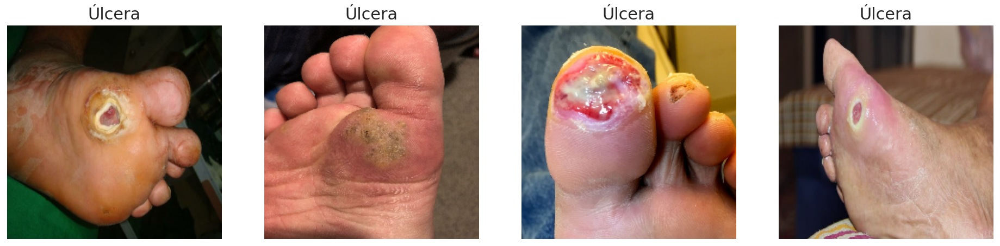

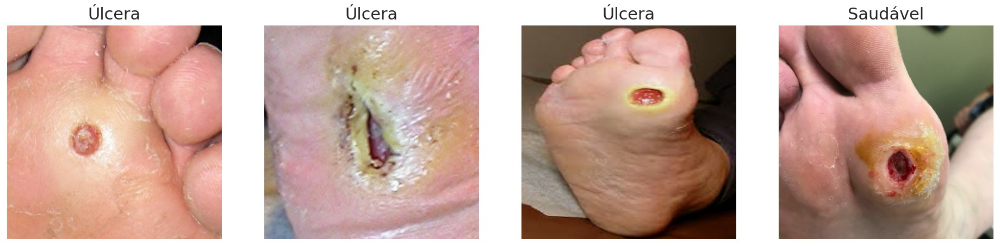

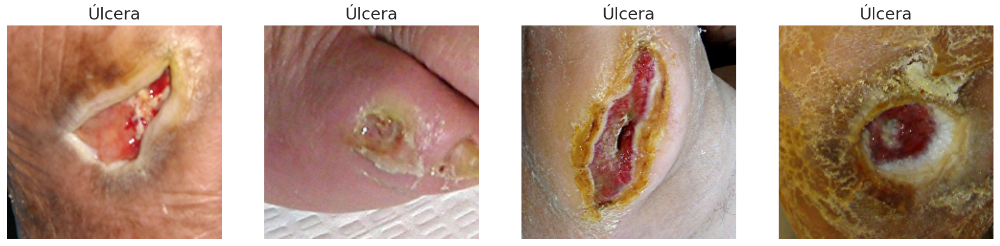

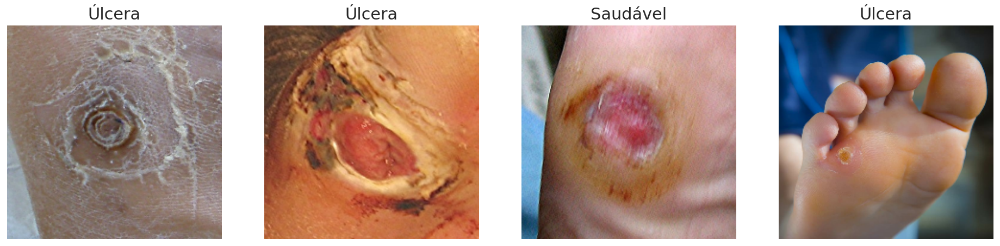

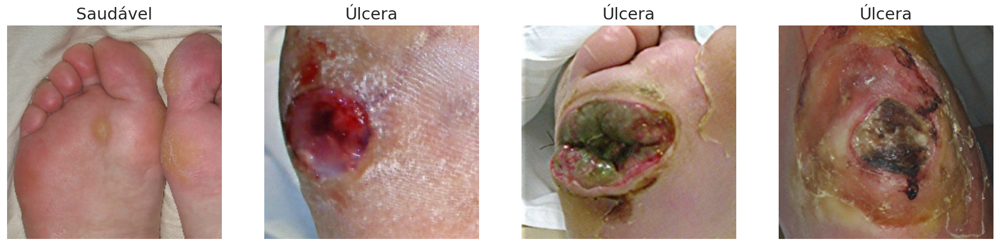

...

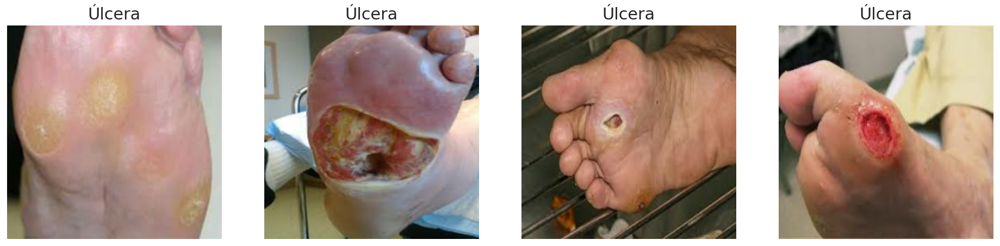

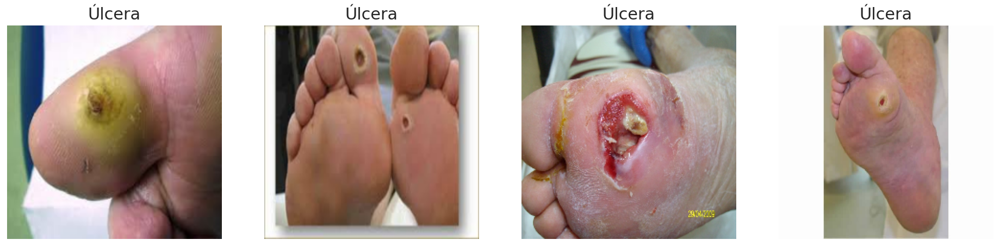

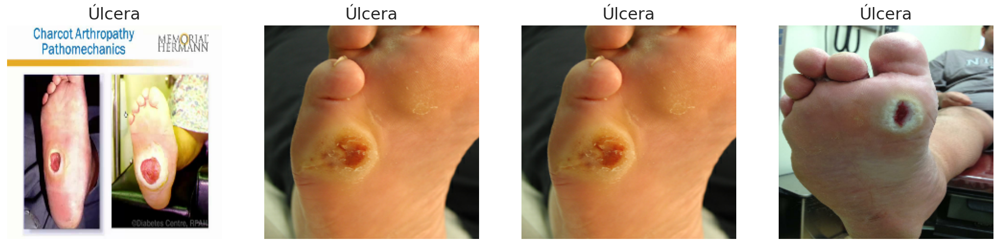

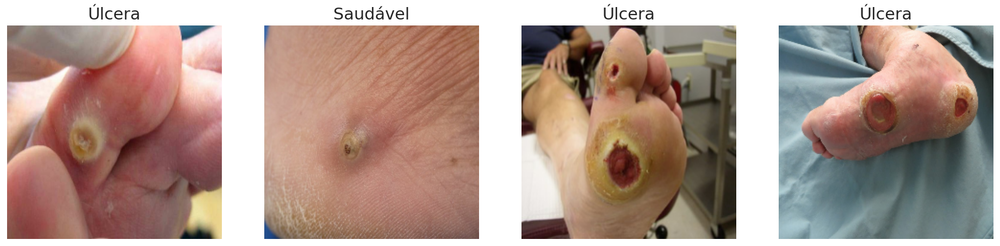

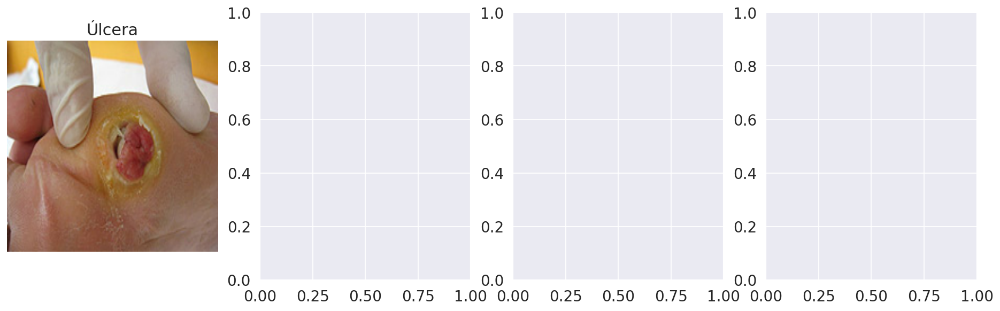

In [27]:
# Visualizando predições das imagens da pasta TestSet

size = len(testeset_images.take(-1))
cols = 4
rows = size // cols + size % cols

index = 0
for i in range(rows):
    fig, axs = plt.subplots(1, cols, figsize = (18,5), dpi = 130)
    
    for j in range(cols):
        index = i * cols + j
        if index >= size:
            break

        image = foot_images[index]
        prediction = foot_predictions[index]
        axs[j].imshow(image.numpy().astype("uint8"))
        title = 'Saudável' if class_names[prediction[0]] == 'Normal(Healthy skin)' else 'Úlcera'
        axs[j].set_title(title)
        axs[j].axis("off")
        